# **Train LLE_UENT for Underwater Image Enhancement**

Date    - 02/08/2023
 
Dataset - EUVP (Enhancing Underwater Visual Perception) Datset

Trained on Kaggle using P100 GPU for 12 hours

Kaggle link for notebook - https://www.kaggle.com/pamuduranasinghe/train-lle-unet-for-underwater/

*Find the complete implementation code for LLE_UNET on [GitHub](https://github.com/pamudu123/Low_Light_Image_Enhancement)*

In [1]:
import os
import random
import csv

## **Data Preperation**

In [2]:
datafolder = r'/kaggle/input/euvp-dataset/EUVP/Paired'

In [3]:
# trainA - uderwater
# trainB - groundtruth

In [4]:
underwater_img_paths = []
groundtruth_img_paths = []

for folder_name in os.listdir(datafolder):
  underwater_img_dir = os.path.join(datafolder,folder_name,'trainA')
  groundtruth_img_dir = os.path.join(datafolder,folder_name,'trainB')

  # Check folders are exists
  print(f'============== {folder_name} ==============')
  if not os.path.exists(underwater_img_dir):
    print(f"{underwater_img_dir} : FOLDER NOT FOUND")
    continue

  if not os.path.exists(groundtruth_img_dir):
    print(f"{groundtruth_img_dir} : FOLDER NOT FOUND")
    continue

  underwater_img_names = os.listdir(underwater_img_dir)
  for underwater_img_name in underwater_img_names:
    underwater_img_path = os.path.join(underwater_img_dir,underwater_img_name)
    groundtruth_img_path = os.path.join(groundtruth_img_dir,underwater_img_name)

    # check groundtruth image exists
    if not os.path.exists(groundtruth_img_path):
      print(f"{groundtruth_img_path} : FOLDER NOT FOUND")
      continue

    underwater_img_paths.append(underwater_img_path)
    groundtruth_img_paths.append(groundtruth_img_path)

  print(f'n_underwater_images : {len(underwater_img_paths)} | n_groundtruth_images : {len(groundtruth_img_paths)} \n')

============== underwater_imagenet ==============
n_underwater_images : 3700 | n_groundtruth_images : 3700 

============== underwater_dark ==============
n_underwater_images : 9250 | n_groundtruth_images : 9250 

============== underwater_scenes ==============
n_underwater_images : 11435 | n_groundtruth_images : 11435 



In [5]:
underwater_img_paths = sorted(underwater_img_paths)
groundtruth_img_paths = sorted(groundtruth_img_paths)

**Train Validation Test Split**

In [6]:
TRAIN_SPLIT      = 0.8
VALIDATION_SPLIT = 0.1
TEST_SPLIT       = 0.1

In [7]:
# Combine the groundtruth and noise image paths into tuples
image_pairs = list(zip(underwater_img_paths,groundtruth_img_paths))

# Shuffle the image pairs randomly
random.shuffle(image_pairs)

# Calculate the number of samples for each split based on the ratios
total_samples = len(image_pairs)
train_samples = int(TRAIN_SPLIT * total_samples)
val_samples = int(VALIDATION_SPLIT * total_samples)
test_samples = total_samples - train_samples - val_samples

# Split the data into train, validation, and test sets
train_data = image_pairs[:train_samples]
val_data = image_pairs[train_samples:train_samples + val_samples]
test_data = image_pairs[train_samples + val_samples:]

**save image paths as csv files for easy data loading**

In [8]:
### Optional
# Save the data into separate CSV files
def save_to_csv(file_path, data):
    with open(file_path, 'w', newline='') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(['UnderWater Images', 'GroundTruth Images'])
        writer.writerows(data)

save_to_csv('train.csv', train_data)
save_to_csv('validation.csv', val_data)
save_to_csv('test.csv', test_data)

# **Training LLE_UNET**

In [9]:
import cv2
import sys
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import math
import random


import tensorflow as tf
from tensorflow.keras.layers import Dense, Activation, Concatenate, GlobalAveragePooling2D, Multiply,GlobalMaxPooling2D
from tensorflow.keras.layers import Conv2D, BatchNormalization, MaxPool2D, Conv2DTranspose, Input
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: l

**Padding Mechanism**

In [10]:
def padding_calc(input_dim,multiplier=32):
    return math.ceil(input_dim/multiplier)*multiplier - input_dim

# Add Padding
def pad_image(image,mood = "center_padding"):
    img_h = image.shape[0]
    img_w = image.shape[1]

    pad_y = padding_calc(img_h)
    pad_x = padding_calc(img_w)

    if mood == "center_padding":
        pad_y2 = pad_y//2
        pad_x2 = pad_x//2

        padded_img = image.copy()
        if pad_y%2 != 0:
            padded_img = np.pad(image, ((pad_y2, pad_y2+1), (pad_x2, pad_x2), (0, 0)), mode='constant')
        if pad_x%2 != 0:
            padded_img = np.pad(image, ((pad_y2, pad_y2), (pad_x2, pad_x2+1), (0, 0)), mode='constant')
        if (pad_y%2 == 0) & (pad_x%2 == 0):
            padded_img = np.pad(image, ((pad_y2, pad_y2), (pad_x2, pad_x2), (0, 0)), mode='constant')

    elif mood == "corner_padding":
        padded_img = np.pad(image, ((0, pad_y), (0, pad_x), (0, 0)), mode='constant')
    return padded_img

# Remove Padding
def inverse_padding(pad_image,image_dim,pad_method="center_padding"):
  pad_img_height = pad_image.shape[0]
  pad_img_width = pad_image.shape[1]

  img_height = image_dim[0]
  img_width = image_dim[1]

  if pad_method == "center_padding":
    pad_y1 = (pad_img_height - img_height)//2
    if pad_y1*2 == (pad_img_height - img_height):pad_y2 = pad_y1
    else: pad_y2 = pad_y1+1

    pad_x1 = (pad_img_width - img_width)//2
    if pad_x1*2 == (pad_img_width - img_width):pad_x2 = pad_x1
    else: pad_x2 = pad_x1+1
    extract_image = pad_image[pad_y1:pad_img_height-pad_y2,pad_x1:pad_img_width-pad_x2]

  if pad_method == "corner_padding":
    extract_image = pad_image[0:img_height,0:img_width]


  return extract_image

In [11]:
# set Radndom Seed
SEED = 0
np.random.seed(SEED)
tf.random.set_seed(SEED)
tf.config.run_functions_eagerly(True)

In [12]:
## test image padding mechanism
test_H = 300
test_W = 533
test_image = np.zeros((test_H, test_W, 3), dtype=np.uint8)
img_pad = pad_image(test_image,'center_padding')
print(test_image.shape,img_pad.shape)

(300, 533, 3) (320, 544, 3)


In [13]:
# Load train test validation image paths form csv files 
def load_excel_data(file_path, column1_name='UnderWater Images', column2_name='GroundTruth Images', sheet_name="Sheet1"):
    try:
        # Load the Excel file
        df = pd.read_csv(file_path)

        # Extract the data from the specified columns
        column1_data = df[column1_name].tolist()
        column2_data = df[column2_name].tolist()

        return column1_data, column2_data

    except Exception as e:
        print(f"Error occurred while loading data from Excel: {e}")
        return None, None

In [14]:
train_csv_path = r'/kaggle/working/train.csv'
test_csv_path = r'/kaggle/working/test.csv'
validation_csv_path = r'/kaggle/working/validation.csv'


train_x_paths, train_y_paths = load_excel_data(train_csv_path)
val_x_paths, val_y_paths = load_excel_data(validation_csv_path)
test_x_paths, test_y_paths = load_excel_data(test_csv_path)

In [15]:
train_x_paths = sorted(train_x_paths)
train_y_paths = sorted(train_y_paths)
val_x_paths = sorted(val_x_paths)
val_y_paths = sorted(val_y_paths)
test_x_paths = sorted(test_x_paths)
test_y_paths = sorted(test_y_paths)

In [16]:
print(f'X_train : {len(train_x_paths)}')
print(f'Y_train : {len(train_y_paths)}')
print(f'X_val   : {len(val_x_paths)}')
print(f'Y_val   : {len(val_y_paths)}')
print(f'X_test  : {len(test_x_paths)}')
print(f'Y_test  : {len(test_y_paths)}')

X_train : 9148
Y_train : 9148
X_val   : 1143
Y_val   : 1143
X_test  : 1144
Y_test  : 1144


In [17]:
# Avoid OOM errors by setting GPU Memory Consumption Growth
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [18]:
@tf.function
def load_image_file(file_path):
    file_path = file_path.numpy().decode("utf-8")
    img = cv2.imread(file_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(256,256))
    # img = cv2.resize(img,(0,0),fx=0.5, fy=0.5)
    preprocess_img = pad_image(img)
    preprocess_img = preprocess_img/255
    return preprocess_img

def image_dataset(image_list):
    files = tf.data.Dataset.from_tensor_slices(image_list)
    dataset = files.map(lambda x: tf.py_function(load_image_file, [x], tf.float32))
    return dataset

In [19]:
BATCH_SIZE = 8

In [20]:
train_x = image_dataset(list(train_x_paths))
train_y = image_dataset(list(train_y_paths))


# combine input and output
train = tf.data.Dataset.zip((train_x, train_y))
# train = train.take(100)
# train = train.shuffle(100)
train = train.batch(BATCH_SIZE)
train.prefetch(tf.data.AUTOTUNE)

/opt/conda/lib/python3.10/site-packages/tensorflow/python/data/ops/structured_function.py:254: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


<_PrefetchDataset element_spec=(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None), TensorSpec(shape=<unknown>, dtype=tf.float32, name=None))>

In [21]:
val_x = image_dataset(list(val_x_paths))
val_y = image_dataset(list(val_y_paths))

# combine input and output
val = tf.data.Dataset.zip((val_x, val_y))
# train = train.shuffle(100)
val = val.batch(BATCH_SIZE)
val.prefetch(tf.data.AUTOTUNE)

<_PrefetchDataset element_spec=(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None), TensorSpec(shape=<unknown>, dtype=tf.float32, name=None))>

In [22]:
test_x = image_dataset(list(test_x_paths))
test_y = image_dataset(list(test_y_paths))

# combine input and output
test = tf.data.Dataset.zip((test_x, test_y))
# test = test.shuffle(100)
test = test.batch(BATCH_SIZE)
test.prefetch(tf.data.AUTOTUNE)

<_PrefetchDataset element_spec=(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None), TensorSpec(shape=<unknown>, dtype=tf.float32, name=None))>

In [23]:
sample = train.take(1)
train_sample = sample.as_numpy_iterator()
res = train_sample.next()

underwater_img1 = res[0][0]
groundtruth_img1 = res[1][0]

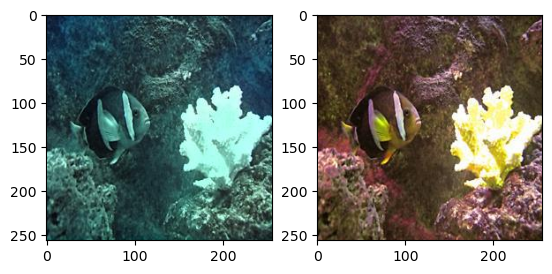

In [24]:
fig, axs = plt.subplots(ncols=2);
axs[0].imshow(underwater_img1);
axs[1].imshow(groundtruth_img1);

### **LLE_UNET**

*CBAM Attention*

In [25]:
def channel_attention_module(x, ratio=8):
    batch, _, _, channel = x.shape

    ## Shared layers
    l1 = Dense(channel//ratio, activation="relu", use_bias=False)
    l2 = Dense(channel, use_bias=False)

    ## Global Average Pooling
    x1 = GlobalAveragePooling2D()(x)
    x1 = l1(x1)
    x1 = l2(x1)

    ## Global Max Pooling
    x2 = GlobalMaxPooling2D()(x)
    x2 = l1(x2)
    x2 = l2(x2)

    ## Add both the features and pass through sigmoid
    feats = x1 + x2
    feats = Activation("sigmoid")(feats)
    feats = Multiply()([x, feats])

    return feats

def spatial_attention_module(x):
    ## Average Pooling
    x1 = tf.reduce_mean(x, axis=-1)
    x1 = tf.expand_dims(x1, axis=-1)

    ## Max Pooling
    x2 = tf.reduce_max(x, axis=-1)
    x2 = tf.expand_dims(x2, axis=-1)

    ## Concatenat both the features
    feats = Concatenate()([x1, x2])
    ## Conv layer
    feats = Conv2D(1, kernel_size=7, padding="same", activation="sigmoid")(feats)
    feats = Multiply()([x, feats])

    return feats

def CBAM(x):
    x = channel_attention_module(x)
    x = spatial_attention_module(x)
    return x

**LLE_UNET Blocks**

In [26]:
def conv_block(input, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x

def encoder_block(input, num_filters):
    x = conv_block(input, num_filters)
    p = MaxPool2D((2, 2))(x)
    return x, p

def decoder_block(input, skip_features, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x

def build_model(input_shape):
    inputs = Input(input_shape)

    vgg_model = VGG16(include_top=False, weights="imagenet",input_tensor=inputs)
    vgg_model.trainable = False

    # Encoder
    s1 = vgg_model.get_layer("block1_conv2").output                             ## (512 x 512)
    s2 = vgg_model.get_layer("block2_conv2").output                             ## (256 x 256)
    s3 = vgg_model.get_layer("block3_conv3").output                             ## (128 x 128)
    s4 = vgg_model.get_layer("block4_conv3").output                             ## (64 x 64)

    b1 = vgg_model.get_layer("block5_conv3").output                             ## (32 x 32)

    # Attention
    s1 = CBAM(s1)
    s2 = CBAM(s2)
    s3 = CBAM(s3)
    s4 = CBAM(s4)

    # Decoder
    d1 = decoder_block(b1, s4, 512)                                             ## (64 x 64)
    d2 = decoder_block(d1, s3, 256)                                             ## (128 x 128)
    d3 = decoder_block(d2, s2, 128)                                             ## (256 x 256)
    d4 = decoder_block(d3, s1, 64)                                              ## (512 x 512)

    # Output
    outputs = Conv2D(3, 1, padding="same", activation="sigmoid")(d4)

    model = Model(inputs, outputs, name="LLE_UNET_undwerwater")
    return model


In [27]:
input_shape = (None, None, 3)
model = build_model(input_shape)
model.summary()

58889256/58889256 [==============================] - 0s 0us/step
Model: "LLE_UNET_undwerwater"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 block1_conv1 (Conv2D)          (None, None, None,   1792        ['input_1[0][0]']                
                                64)                                                               
                                                                                                  
 block1_conv2 (Conv2D)          (None, None, None,   36928       ['block1_conv1[0][0]']           
              

In [28]:
print("trainable_weights:", len(model.trainable_weights))
print("non_trainable_weights:", len(model.non_trainable_weights))

trainable_weights: 58
non_trainable_weights: 42


In [29]:
#optimizer = tf.keras.optimizers.experimental.AdamW(learning_rate=0.0001,weight_decay=0.004)
optimizer = tf.keras.optimizers.Adam(learning_rate=3e-4)
MSEloss = tf.keras.losses.MeanSquaredError()

def charbonnier_loss(y_true, y_pred):
    return tf.reduce_mean(tf.sqrt(tf.square(y_true - y_pred) + tf.square(1e-3)))

def psnr_loss_fn(y_true, y_pred):
    return tf.image.psnr(y_pred, y_true, max_val=1.0)

def ssim_loss_fn(y_true,y_pred):
    return tf.image.ssim(y_true,y_pred,1.0)

**Tensorflow callabck**

In [30]:
from keras.callbacks import ModelCheckpoint

# tensorboard callback
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir="./logs")

**save_best_model_callback**

In [31]:
from datetime import datetime
model_save_folder = datetime.now().strftime("%Y%m%d_%H%M%S")
model_save_dir = f'models/{model_save_folder}'
#model_save_dir = f'models'

if not os.path.exists(model_save_dir):
  print("FOLDER CREATED")
  os.makedirs(model_save_dir)

save_best_model_checkpoint = ModelCheckpoint(model_save_dir+'/model-{epoch:03d}.hdf5',monitor='val_loss',save_best_only=True,mode='auto')

FOLDER CREATED


In [32]:
def preprocess_image(img_path):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img,(256,256))
    preprocess_img = pad_image(img)
    preprocess_img = preprocess_img/255;
    return preprocess_img

In [33]:
def infer(x_paths,y_paths,n_images=2):
    for i,x_image_path in enumerate(x_paths):
        if i == n_images:
            break
        print(f'{i+1}/{n_images} : {x_image_path}')
        x_img = preprocess_image(x_image_path)
        prediction = model.predict(np.expand_dims(x_img,axis=0),verbose=0)

        y_img_path = y_paths[i]
        y_img = preprocess_image(y_img_path)

        fig, ax = plt.subplots(ncols=3, figsize=(15,10));
        ax[0].imshow(x_img);
        ax[1].imshow(prediction[0]);
        ax[2].imshow(y_img);
        ax[0].axis('off');
        ax[1].axis('off');
        ax[2].axis('off');
        ax[0].set_title("UnderWater Image")
        ax[1].set_title("Predicted Image")
        ax[2].set_title("GroundTruth Image")
        plt.show()

In [34]:
from tensorflow.keras import callbacks
class PredictionCallback(callbacks.Callback):
    def __init__(self, log_interval, *args, **kwargs):
        super().__init__(*args, **kwargs)
        #self.image_files = image_files
        self.log_interval = log_interval

    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.log_interval == 0:
            infer(train_x_paths,train_y_paths,n_images=2)


In [35]:
#model.compile(optimizer,loss, metrics = [charbonnier_loss,psnr_loss_fn,ssim_loss_fn])
model.compile(optimizer,charbonnier_loss, metrics = [MSEloss,psnr_loss_fn,ssim_loss_fn])

**Train Model**

In [36]:
LOG_INTERVALS = 5
EPOCHS        = 50

Epoch 1/50
1144/1144 [==============================] - ETA: 0s - loss: 0.0829 - mean_squared_error: 0.0141 - psnr_loss_fn: 19.5028 - ssim_loss_fn: 0.73491/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264286_00007889.jpg


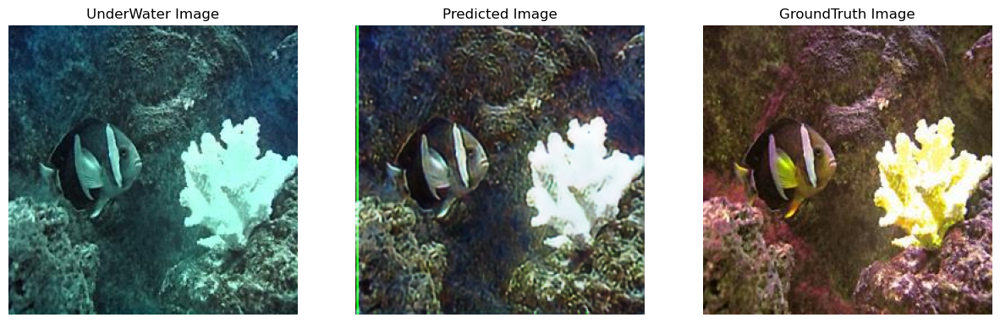

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


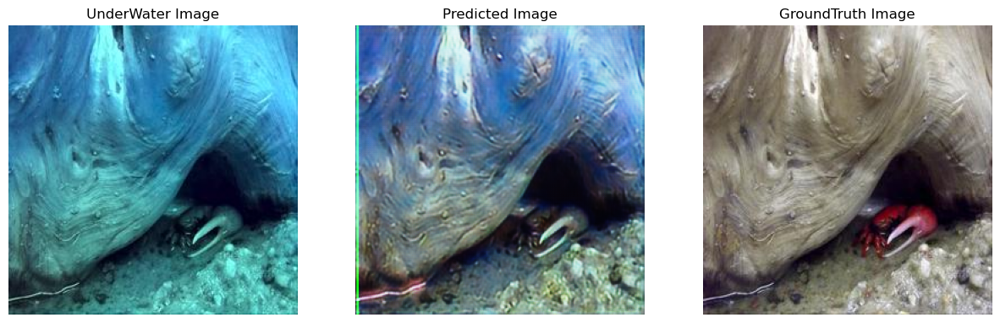

1144/1144 [==============================] - 656s 562ms/step - loss: 0.0829 - mean_squared_error: 0.0141 - psnr_loss_fn: 19.5028 - ssim_loss_fn: 0.7349 - val_loss: 0.0838 - val_mean_squared_error: 0.0145 - val_psnr_loss_fn: 19.2552 - val_ssim_loss_fn: 0.7553
Epoch 2/50
1144/1144 [==============================] - 620s 542ms/step - loss: 0.0728 - mean_squared_error: 0.0106 - psnr_loss_fn: 20.6151 - ssim_loss_fn: 0.7825 - val_loss: 0.0793 - val_mean_squared_error: 0.0128 - val_psnr_loss_fn: 19.9347 - val_ssim_loss_fn: 0.7726
Epoch 3/50
1144/1144 [==============================] - 613s 536ms/step - loss: 0.0691 - mean_squared_error: 0.0096 - psnr_loss_fn: 21.0584 - ssim_loss_fn: 0.7927 - val_loss: 0.0829 - val_mean_squared_error: 0.0138 - val_psnr_loss_fn: 19.5945 - val_ssim_loss_fn: 0.7752
Epoch 4/50
1144/1144 [==============================] - 618s 540ms/step - loss: 0.0666 - mean_squared_error: 0.0091 - psnr_loss_fn: 21.3236 - ssim_loss_fn: 0.7999 - val_loss: 0.0772 - val_mean_squared_

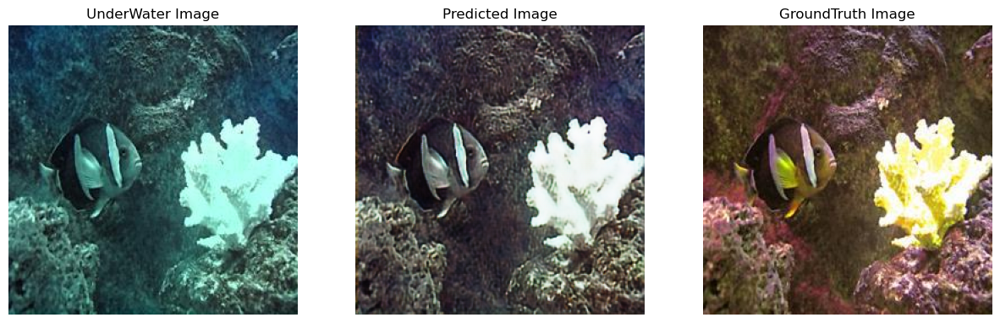

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


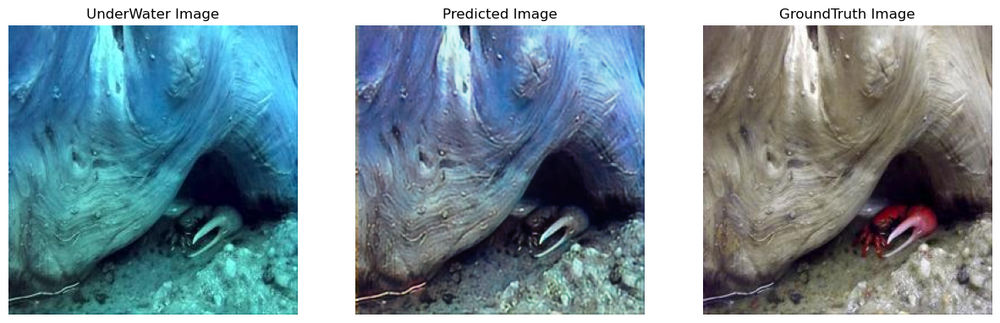

1144/1144 [==============================] - 617s 539ms/step - loss: 0.0626 - mean_squared_error: 0.0078 - psnr_loss_fn: 22.1592 - ssim_loss_fn: 0.8137 - val_loss: 0.0753 - val_mean_squared_error: 0.0118 - val_psnr_loss_fn: 20.8106 - val_ssim_loss_fn: 0.8036
Epoch 7/50
1144/1144 [==============================] - 599s 523ms/step - loss: 0.0598 - mean_squared_error: 0.0073 - psnr_loss_fn: 22.5628 - ssim_loss_fn: 0.8335 - val_loss: 0.0748 - val_mean_squared_error: 0.0116 - val_psnr_loss_fn: 20.9805 - val_ssim_loss_fn: 0.8122
Epoch 8/50
1144/1144 [==============================] - 599s 523ms/step - loss: 0.0580 - mean_squared_error: 0.0069 - psnr_loss_fn: 22.8210 - ssim_loss_fn: 0.8423 - val_loss: 0.0750 - val_mean_squared_error: 0.0117 - val_psnr_loss_fn: 21.0013 - val_ssim_loss_fn: 0.8129
Epoch 9/50
1144/1144 [==============================] - 596s 521ms/step - loss: 0.0568 - mean_squared_error: 0.0067 - psnr_loss_fn: 23.0014 - ssim_loss_fn: 0.8471 - val_loss: 0.0743 - val_mean_squared_

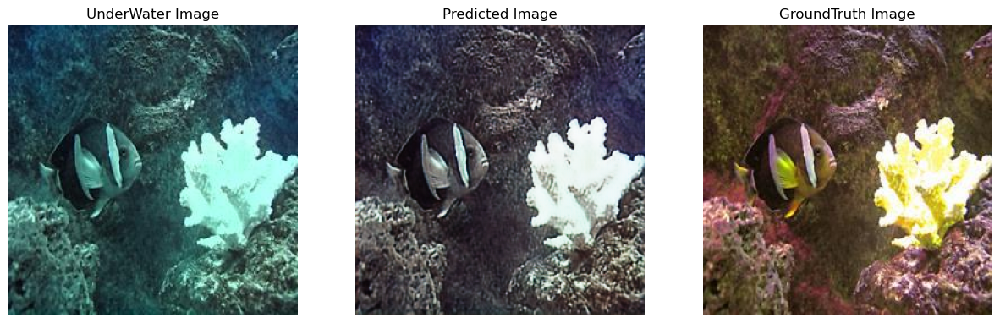

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


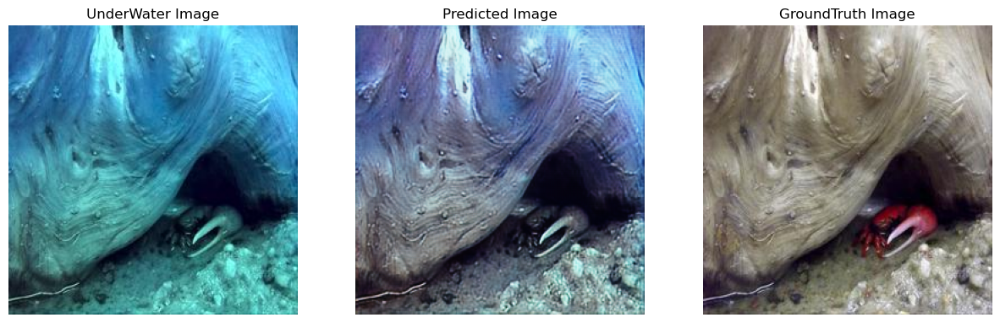

1144/1144 [==============================] - 602s 527ms/step - loss: 0.0548 - mean_squared_error: 0.0063 - psnr_loss_fn: 23.2726 - ssim_loss_fn: 0.8533 - val_loss: 0.0751 - val_mean_squared_error: 0.0119 - val_psnr_loss_fn: 20.9993 - val_ssim_loss_fn: 0.8131
Epoch 12/50
1144/1144 [==============================] - 607s 530ms/step - loss: 0.0540 - mean_squared_error: 0.0061 - psnr_loss_fn: 23.3944 - ssim_loss_fn: 0.8556 - val_loss: 0.0754 - val_mean_squared_error: 0.0119 - val_psnr_loss_fn: 20.9911 - val_ssim_loss_fn: 0.8130
Epoch 13/50
1144/1144 [==============================] - 601s 525ms/step - loss: 0.0534 - mean_squared_error: 0.0060 - psnr_loss_fn: 23.4663 - ssim_loss_fn: 0.8571 - val_loss: 0.0784 - val_mean_squared_error: 0.0130 - val_psnr_loss_fn: 20.6176 - val_ssim_loss_fn: 0.8086
Epoch 14/50
1144/1144 [==============================] - 599s 524ms/step - loss: 0.0531 - mean_squared_error: 0.0059 - psnr_loss_fn: 23.5155 - ssim_loss_fn: 0.8583 - val_loss: 0.0787 - val_mean_squar

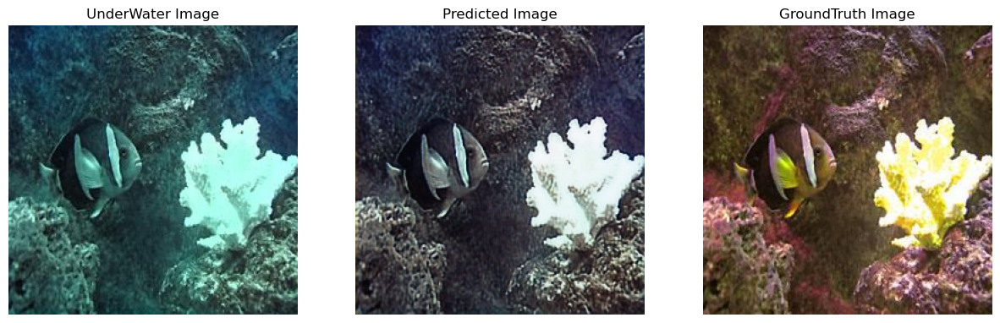

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


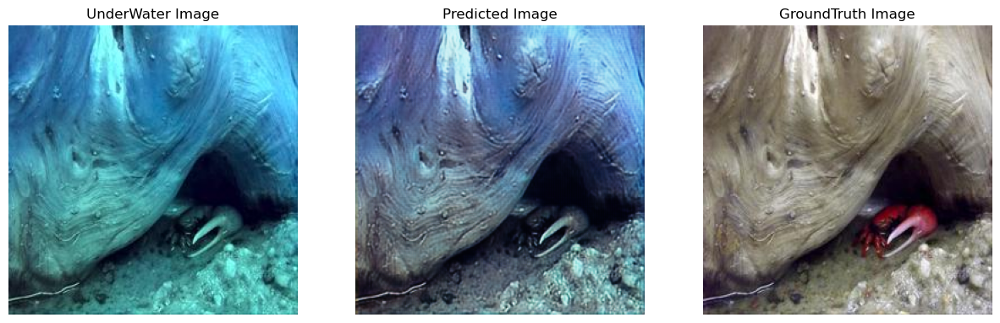

1144/1144 [==============================] - 598s 523ms/step - loss: 0.0522 - mean_squared_error: 0.0058 - psnr_loss_fn: 23.6524 - ssim_loss_fn: 0.8603 - val_loss: 0.0810 - val_mean_squared_error: 0.0135 - val_psnr_loss_fn: 20.4362 - val_ssim_loss_fn: 0.8102
Epoch 17/50
1144/1144 [==============================] - 605s 529ms/step - loss: 0.0517 - mean_squared_error: 0.0057 - psnr_loss_fn: 23.7199 - ssim_loss_fn: 0.8610 - val_loss: 0.0790 - val_mean_squared_error: 0.0130 - val_psnr_loss_fn: 20.6548 - val_ssim_loss_fn: 0.8156
Epoch 18/50
1144/1144 [==============================] - 616s 539ms/step - loss: 0.0514 - mean_squared_error: 0.0056 - psnr_loss_fn: 23.7749 - ssim_loss_fn: 0.8616 - val_loss: 0.0792 - val_mean_squared_error: 0.0132 - val_psnr_loss_fn: 20.6294 - val_ssim_loss_fn: 0.8141
Epoch 19/50
1144/1144 [==============================] - 608s 531ms/step - loss: 0.0512 - mean_squared_error: 0.0055 - psnr_loss_fn: 23.7941 - ssim_loss_fn: 0.8621 - val_loss: 0.0801 - val_mean_squar

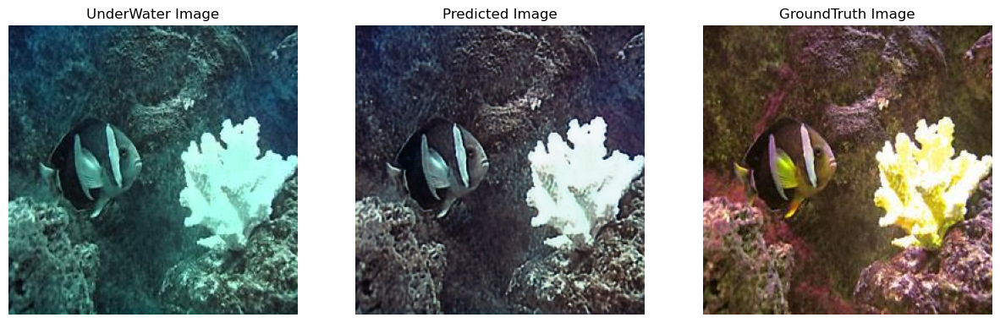

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


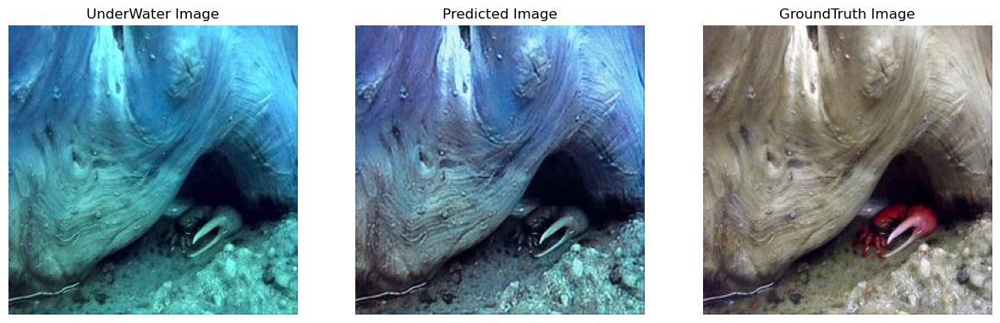

1144/1144 [==============================] - 608s 531ms/step - loss: 0.0505 - mean_squared_error: 0.0054 - psnr_loss_fn: 23.8929 - ssim_loss_fn: 0.8634 - val_loss: 0.0802 - val_mean_squared_error: 0.0137 - val_psnr_loss_fn: 20.4995 - val_ssim_loss_fn: 0.8142
Epoch 22/50
1144/1144 [==============================] - 602s 526ms/step - loss: 0.0501 - mean_squared_error: 0.0053 - psnr_loss_fn: 23.9449 - ssim_loss_fn: 0.8638 - val_loss: 0.0830 - val_mean_squared_error: 0.0145 - val_psnr_loss_fn: 20.2066 - val_ssim_loss_fn: 0.8066
Epoch 23/50
1144/1144 [==============================] - 606s 530ms/step - loss: 0.0501 - mean_squared_error: 0.0053 - psnr_loss_fn: 23.9507 - ssim_loss_fn: 0.8638 - val_loss: 0.0838 - val_mean_squared_error: 0.0147 - val_psnr_loss_fn: 20.0876 - val_ssim_loss_fn: 0.8070
Epoch 24/50
1144/1144 [==============================] - 598s 522ms/step - loss: 0.0497 - mean_squared_error: 0.0052 - psnr_loss_fn: 24.0020 - ssim_loss_fn: 0.8644 - val_loss: 0.0818 - val_mean_squar

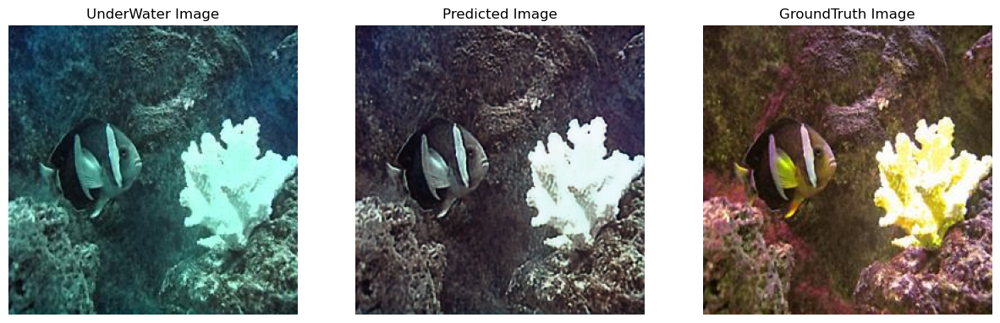

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


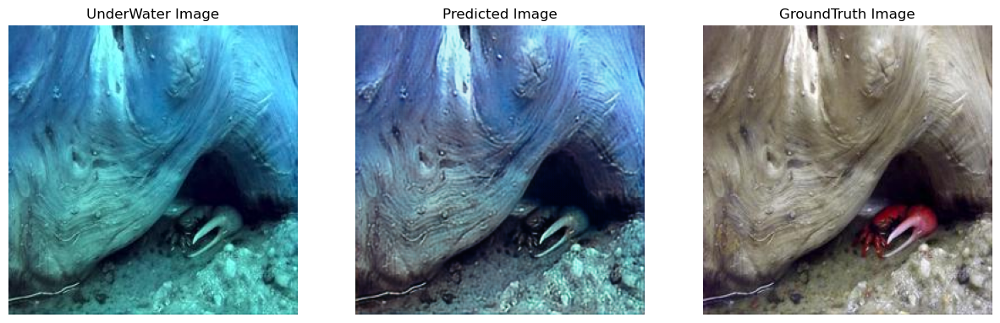

1144/1144 [==============================] - 608s 532ms/step - loss: 0.0490 - mean_squared_error: 0.0050 - psnr_loss_fn: 24.1142 - ssim_loss_fn: 0.8656 - val_loss: 0.0793 - val_mean_squared_error: 0.0135 - val_psnr_loss_fn: 20.6222 - val_ssim_loss_fn: 0.8122
Epoch 27/50
1144/1144 [==============================] - 605s 529ms/step - loss: 0.0486 - mean_squared_error: 0.0050 - psnr_loss_fn: 24.1804 - ssim_loss_fn: 0.8662 - val_loss: 0.0824 - val_mean_squared_error: 0.0143 - val_psnr_loss_fn: 20.2953 - val_ssim_loss_fn: 0.8088
Epoch 28/50
1144/1144 [==============================] - 601s 525ms/step - loss: 0.0482 - mean_squared_error: 0.0049 - psnr_loss_fn: 24.2352 - ssim_loss_fn: 0.8667 - val_loss: 0.0795 - val_mean_squared_error: 0.0134 - val_psnr_loss_fn: 20.6492 - val_ssim_loss_fn: 0.8135
Epoch 29/50
1144/1144 [==============================] - 612s 535ms/step - loss: 0.0477 - mean_squared_error: 0.0048 - psnr_loss_fn: 24.3229 - ssim_loss_fn: 0.8676 - val_loss: 0.0777 - val_mean_squar

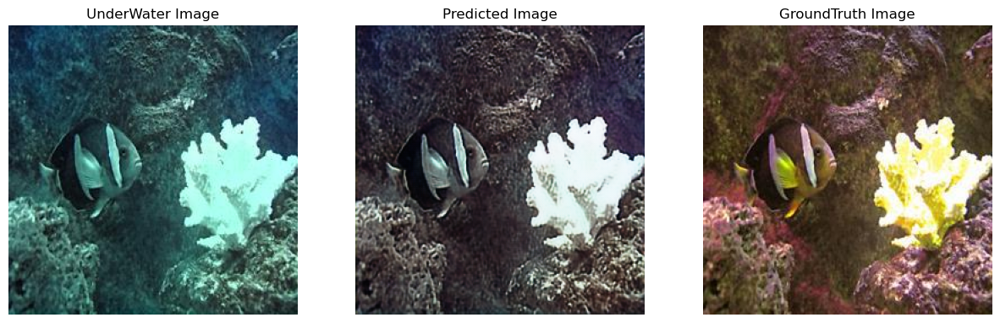

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


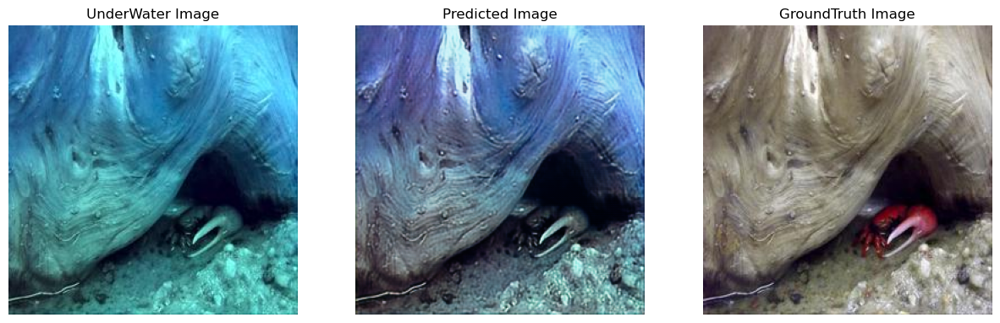

1144/1144 [==============================] - 616s 538ms/step - loss: 0.0473 - mean_squared_error: 0.0047 - psnr_loss_fn: 24.3756 - ssim_loss_fn: 0.8683 - val_loss: 0.0795 - val_mean_squared_error: 0.0132 - val_psnr_loss_fn: 20.6215 - val_ssim_loss_fn: 0.8131
Epoch 32/50
1144/1144 [==============================] - 611s 534ms/step - loss: 0.0471 - mean_squared_error: 0.0046 - psnr_loss_fn: 24.4086 - ssim_loss_fn: 0.8686 - val_loss: 0.0824 - val_mean_squared_error: 0.0142 - val_psnr_loss_fn: 20.2599 - val_ssim_loss_fn: 0.8080
Epoch 33/50
1144/1144 [==============================] - 614s 536ms/step - loss: 0.0468 - mean_squared_error: 0.0046 - psnr_loss_fn: 24.4545 - ssim_loss_fn: 0.8689 - val_loss: 0.0802 - val_mean_squared_error: 0.0134 - val_psnr_loss_fn: 20.5668 - val_ssim_loss_fn: 0.8138
Epoch 34/50
1144/1144 [==============================] - 616s 538ms/step - loss: 0.0468 - mean_squared_error: 0.0046 - psnr_loss_fn: 24.4524 - ssim_loss_fn: 0.8689 - val_loss: 0.0809 - val_mean_squar

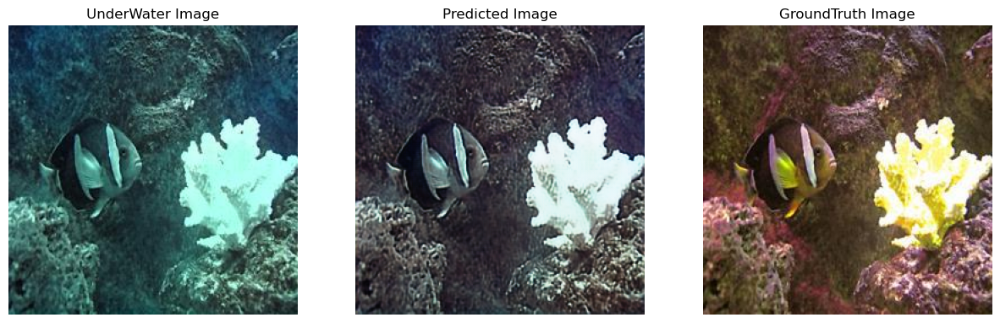

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


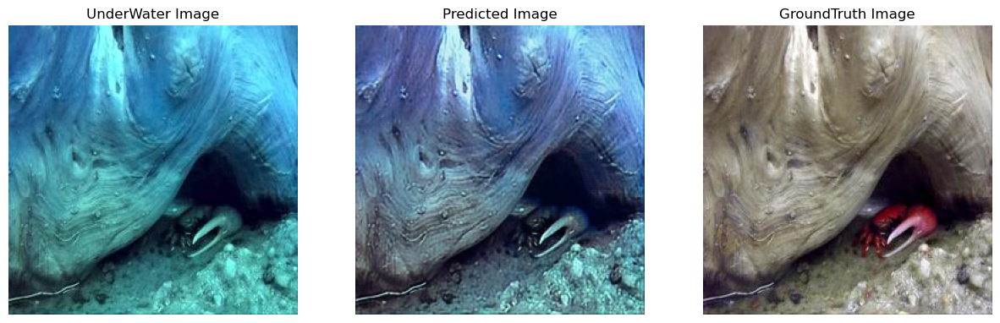

1144/1144 [==============================] - 618s 540ms/step - loss: 0.0464 - mean_squared_error: 0.0045 - psnr_loss_fn: 24.5270 - ssim_loss_fn: 0.8695 - val_loss: 0.0839 - val_mean_squared_error: 0.0147 - val_psnr_loss_fn: 20.1029 - val_ssim_loss_fn: 0.8081
Epoch 37/50
1144/1144 [==============================] - 609s 532ms/step - loss: 0.0462 - mean_squared_error: 0.0044 - psnr_loss_fn: 24.5591 - ssim_loss_fn: 0.8696 - val_loss: 0.0858 - val_mean_squared_error: 0.0153 - val_psnr_loss_fn: 19.9092 - val_ssim_loss_fn: 0.8045
Epoch 38/50
1144/1144 [==============================] - 612s 535ms/step - loss: 0.0458 - mean_squared_error: 0.0044 - psnr_loss_fn: 24.6343 - ssim_loss_fn: 0.8702 - val_loss: 0.0847 - val_mean_squared_error: 0.0148 - val_psnr_loss_fn: 20.0784 - val_ssim_loss_fn: 0.8069
Epoch 39/50
1144/1144 [==============================] - 613s 535ms/step - loss: 0.0455 - mean_squared_error: 0.0043 - psnr_loss_fn: 24.6718 - ssim_loss_fn: 0.8706 - val_loss: 0.0865 - val_mean_squar

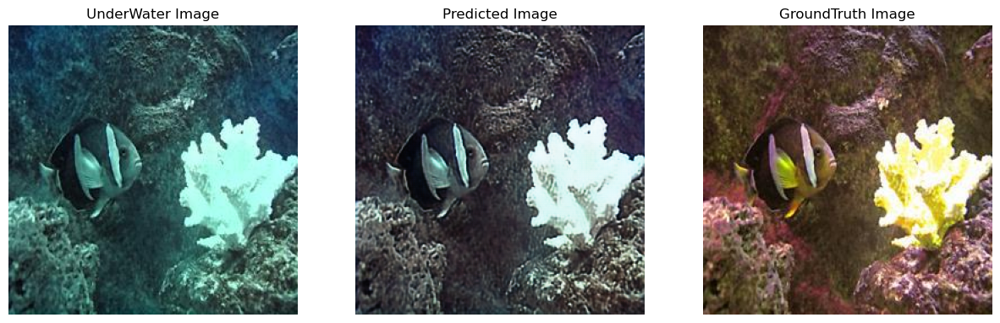

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


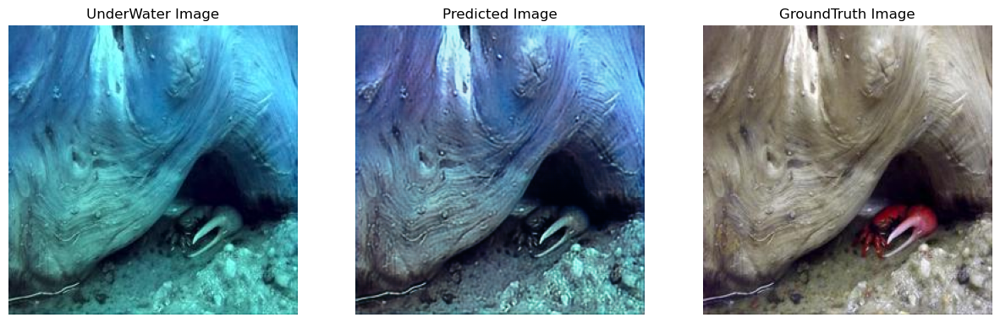

1144/1144 [==============================] - 626s 547ms/step - loss: 0.0449 - mean_squared_error: 0.0042 - psnr_loss_fn: 24.7803 - ssim_loss_fn: 0.8715 - val_loss: 0.0822 - val_mean_squared_error: 0.0142 - val_psnr_loss_fn: 20.3343 - val_ssim_loss_fn: 0.8112
Epoch 42/50
1144/1144 [==============================] - 614s 536ms/step - loss: 0.0447 - mean_squared_error: 0.0042 - psnr_loss_fn: 24.8122 - ssim_loss_fn: 0.8719 - val_loss: 0.0795 - val_mean_squared_error: 0.0133 - val_psnr_loss_fn: 20.5953 - val_ssim_loss_fn: 0.8151
Epoch 43/50
1144/1144 [==============================] - 609s 532ms/step - loss: 0.0444 - mean_squared_error: 0.0041 - psnr_loss_fn: 24.8599 - ssim_loss_fn: 0.8724 - val_loss: 0.0811 - val_mean_squared_error: 0.0139 - val_psnr_loss_fn: 20.4463 - val_ssim_loss_fn: 0.8114
Epoch 44/50
1144/1144 [==============================] - 605s 529ms/step - loss: 0.0442 - mean_squared_error: 0.0041 - psnr_loss_fn: 24.8905 - ssim_loss_fn: 0.8727 - val_loss: 0.0849 - val_mean_squar

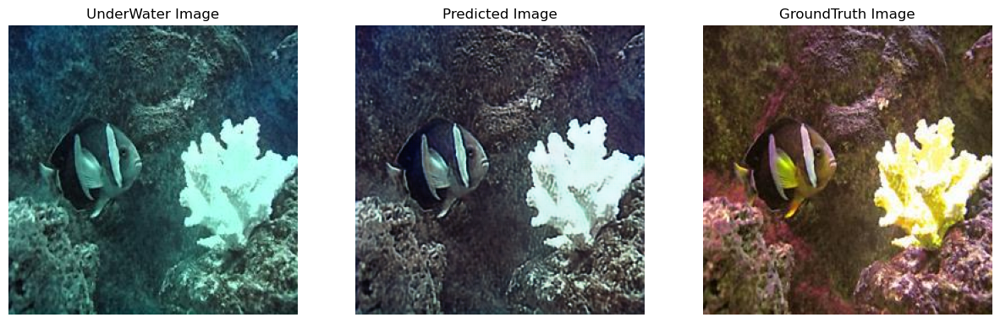

2/2 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264287_00007863.jpg


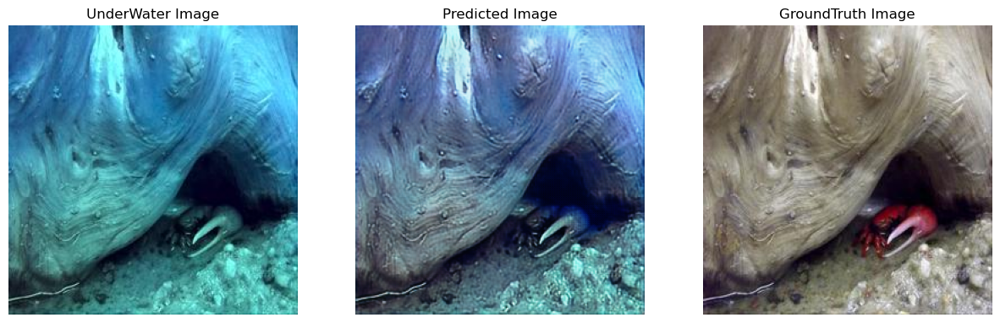

1144/1144 [==============================] - 604s 528ms/step - loss: 0.0436 - mean_squared_error: 0.0040 - psnr_loss_fn: 24.9991 - ssim_loss_fn: 0.8735 - val_loss: 0.0836 - val_mean_squared_error: 0.0146 - val_psnr_loss_fn: 20.1811 - val_ssim_loss_fn: 0.8087
Epoch 47/50
1144/1144 [==============================] - 607s 530ms/step - loss: 0.0435 - mean_squared_error: 0.0039 - psnr_loss_fn: 25.0297 - ssim_loss_fn: 0.8739 - val_loss: 0.0793 - val_mean_squared_error: 0.0132 - val_psnr_loss_fn: 20.6161 - val_ssim_loss_fn: 0.8166
Epoch 48/50
1144/1144 [==============================] - 606s 530ms/step - loss: 0.0432 - mean_squared_error: 0.0039 - psnr_loss_fn: 25.0759 - ssim_loss_fn: 0.8742 - val_loss: 0.0858 - val_mean_squared_error: 0.0151 - val_psnr_loss_fn: 19.9150 - val_ssim_loss_fn: 0.8064
Epoch 49/50
1144/1144 [==============================] - 608s 532ms/step - loss: 0.0430 - mean_squared_error: 0.0038 - psnr_loss_fn: 25.1017 - ssim_loss_fn: 0.8743 - val_loss: 0.0823 - val_mean_squar

In [37]:
# Train for 50 epochs

hist = model.fit(train, epochs = EPOCHS, validation_data = val, callbacks=[tensorboard_callback,save_best_model_checkpoint,
                                                                        PredictionCallback(log_interval = LOG_INTERVALS)])

**Save weights**

In [38]:
# save weights
model.save("LLE_UNET_UNDWERWATER.h5")

# save entire model
model.save('LLE_UNET_UNDWERWATER')

**Loss curves**

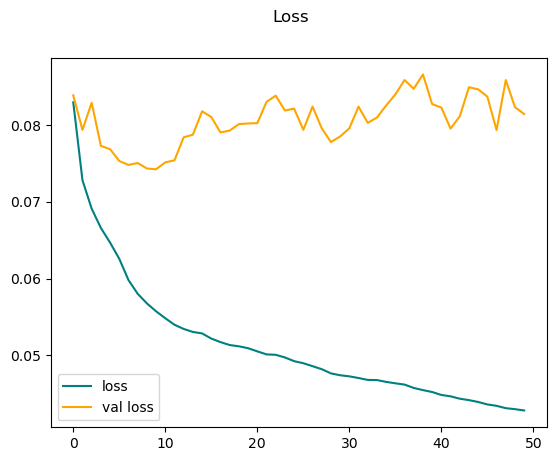

In [39]:
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val loss')
plt.suptitle('Loss')
plt.legend()
plt.show()

**Tensorboard Visulaization**

In [40]:
%load_ext tensorboard

In [41]:
%tensorboard --logdir '/kaggle/working/logs'

**Model Inference on test data**

1/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264288_00012917.jpg


/opt/conda/lib/python3.10/site-packages/tensorflow/python/data/ops/structured_function.py:254: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


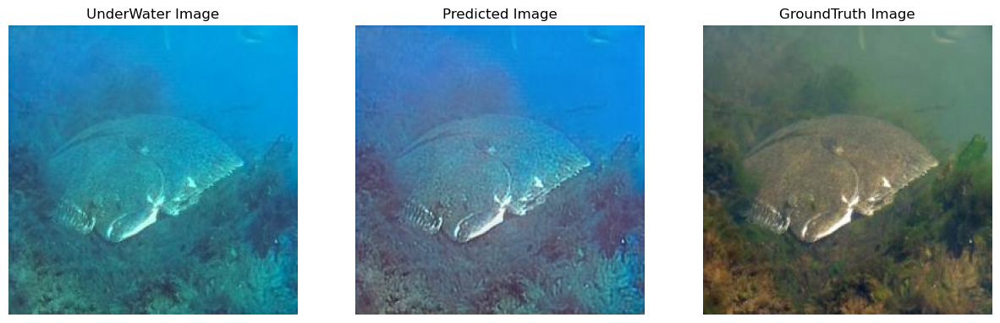

2/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264303_n02526121_4809.JPEG


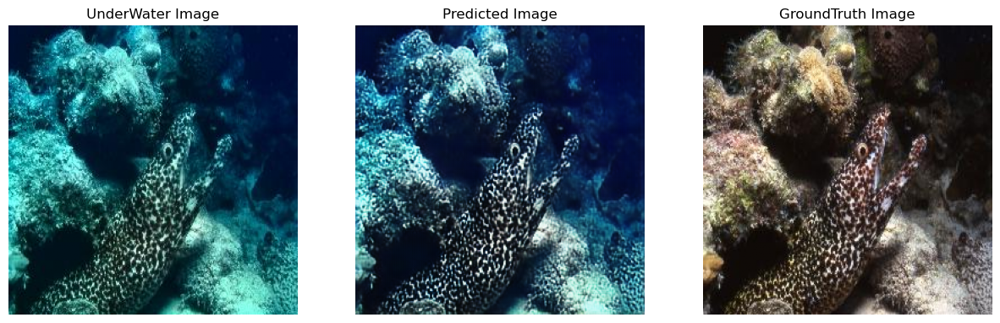

3/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264348_n02655020_9849.JPEG


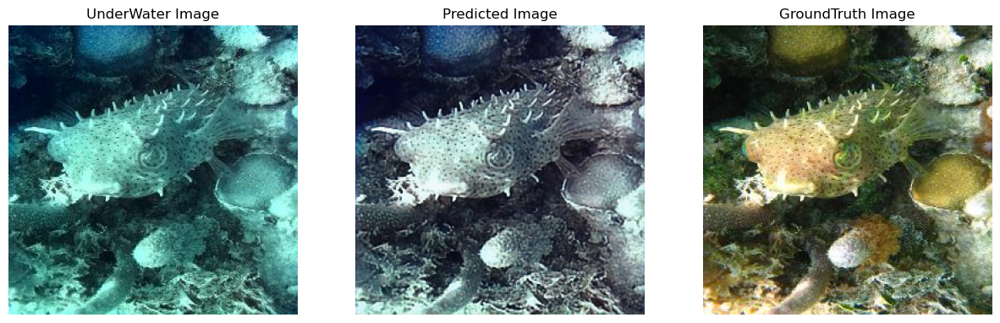

4/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264365_scuba_thanksgiving_520.jpg


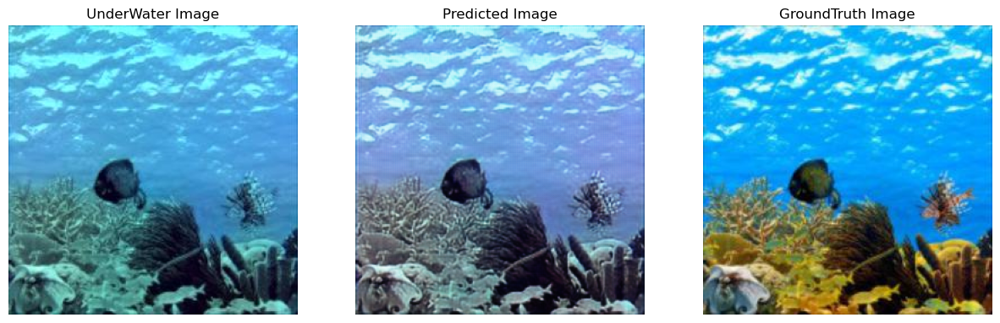

5/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264367_00022286.jpg


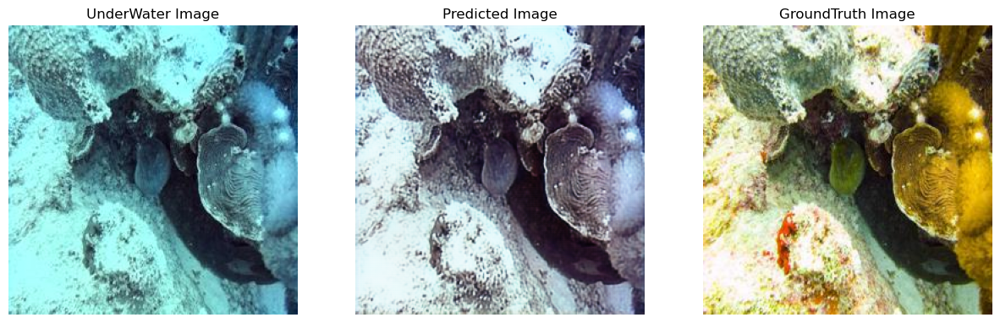

6/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264369_00011297.jpg


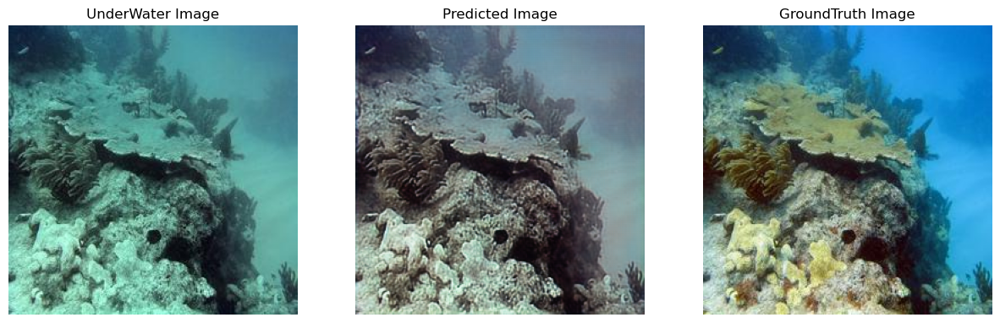

7/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264400_00022977.jpg


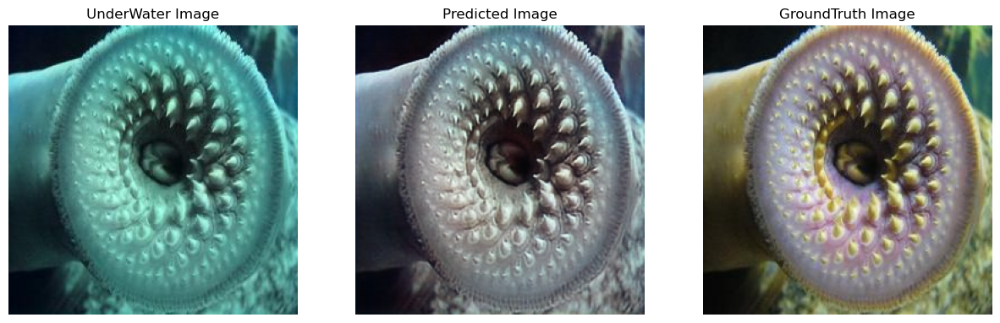

8/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264433_00031637.jpg


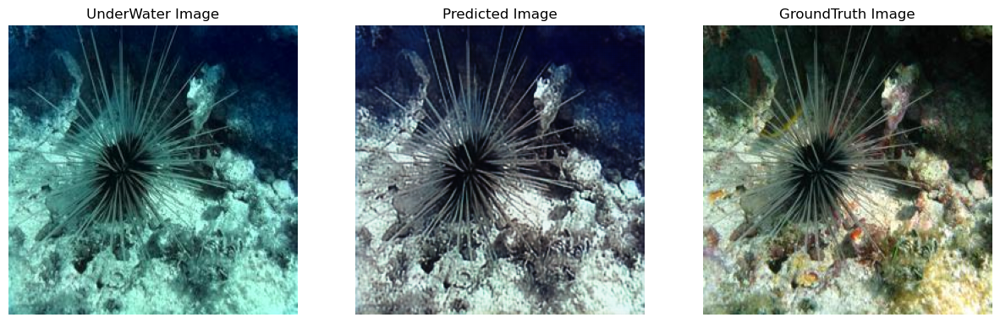

9/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264443_n02655020_14093.JPEG


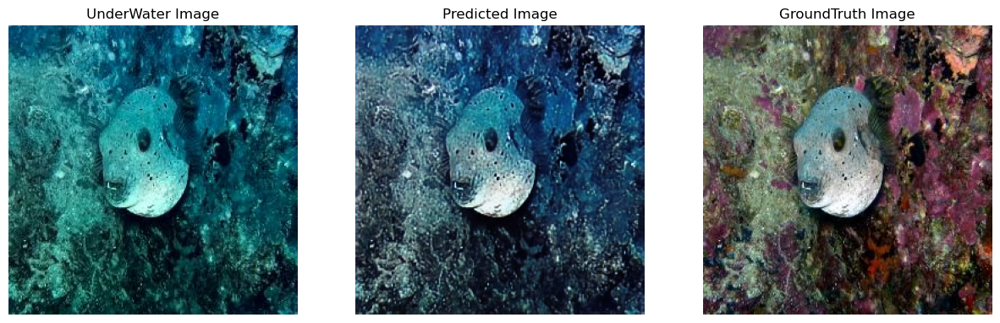

10/10 : /kaggle/input/euvp-dataset/EUVP/Paired/underwater_dark/trainA/264460_n09256479_3820.JPEG


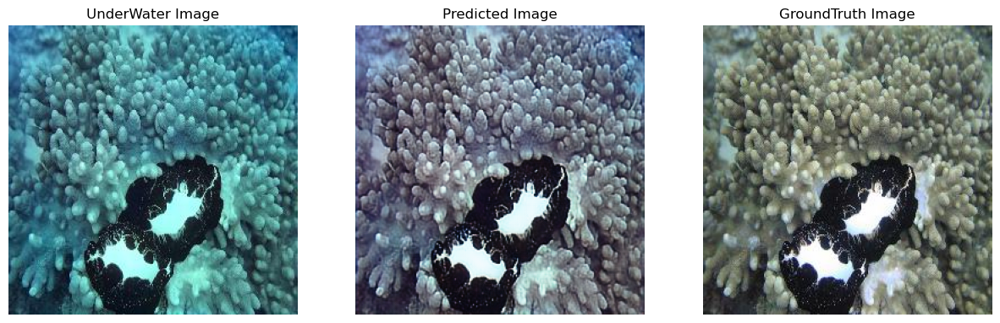

In [42]:
# on test images
infer(test_x_paths,test_y_paths,n_images=10)

**LLE_UNET** is a versatile model. 
Train it for your use case and share the results with us !!!

If you have any concerns, please open an issue on [GitHub](https://github.com/pamudu123/Low_Light_Image_Enhancement). We are happy to assist you.

*Pamudu Ranasinghe*
[Linkedin](https://www.linkedin.com/in/pamudu-ranasinghe/)
